In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.dates as mdates
from utils.aemepy import Rn_Clima_subplots, Rn_Clima_plot
from scipy.stats.stats import pearsonr
plt.rc('text',usetex=True)
plt.rc('font',family='serif')
plt.rcParams['xtick.labelsize']=12
plt.rcParams['ytick.labelsize']=12

In [2]:
# Load Cities:
list_cities = ['BCN', 'NVR', 'HSC', 'ZGZ']
weekly = {}
for city in list_cities:
    weekly[city] = pd.read_csv(f'~/CIEMAT/Rn_Weekly_NN/AEMET/Data/Daily/{city}/{city}_weekly.csv',
                            usecols=['fecha', 'tmed', 'presmed', 'velmedia'])
    weekly[city + '_avg'] = pd.read_csv(f'~/CIEMAT/Rn_Weekly_NN/AEMET/Data/Daily/{city}/{city}_avg_weekly.csv',
                                     usecols=['fecha', 'tmed', 'presmed', 'velmedia'])

In [3]:
# Load Rn:
mdnRnA = np.loadtxt('../../mdnRnA.txt', delimiter=',')
startday = pd.datetime(2013, 7, 1)
dates = pd.date_range(startday, periods=len(mdnRnA), freq='W')

In [4]:
assert len(mdnRnA) == len(weekly['BCN']['fecha'].values)

# Plots with Temperature

## Not nulls

In [5]:
BCN = weekly['BCN']
BCN['fecha'] = pd.to_datetime(BCN['fecha'])
NVR = weekly['NVR']
NVR['fecha'] = pd.to_datetime(NVR['fecha'])
HSC = weekly['HSC']
HSC['fecha'] = pd.to_datetime(HSC['fecha'])
ZGZ = weekly['ZGZ']
ZGZ['fecha'] = pd.to_datetime(ZGZ['fecha'])
DF_list = [BCN, NVR, ZGZ, HSC]
arr_str = ['BCN', 'NVR', 'ZGZ', 'HSC']

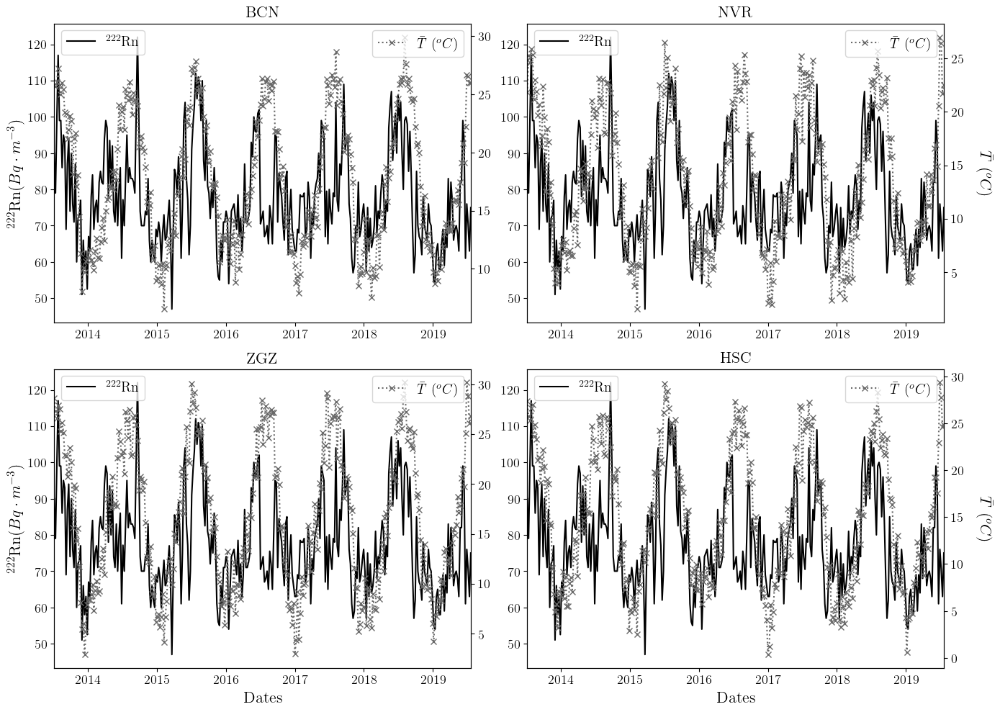

In [8]:
fig = plt.figure(1, figsize=(14, 10), dpi=100)
Rn_Clima_subplots(DF_list, mdnRnA, dates, 'tmed', arr_str, ylabel=r'\bar{T}\ (^o C)', c='dimgray', v='T')

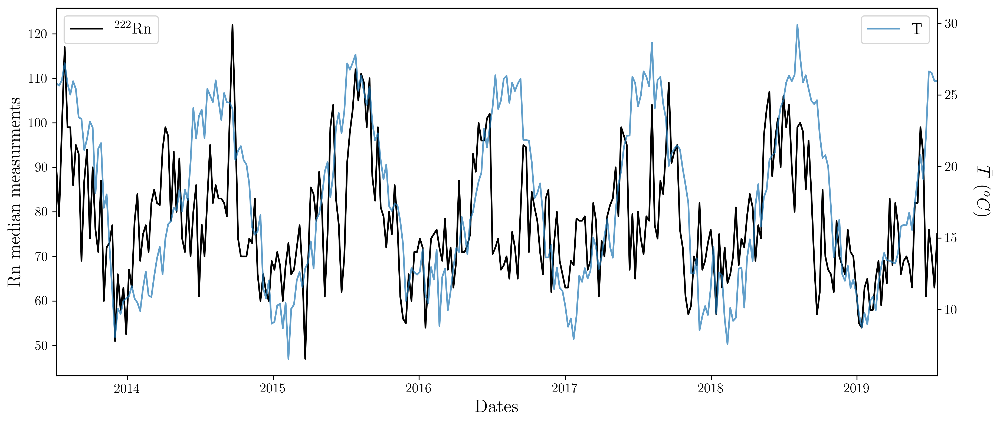

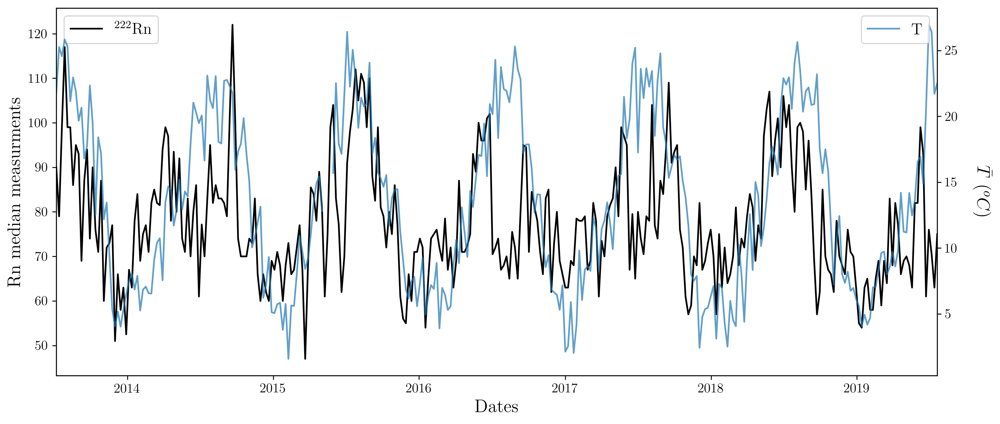

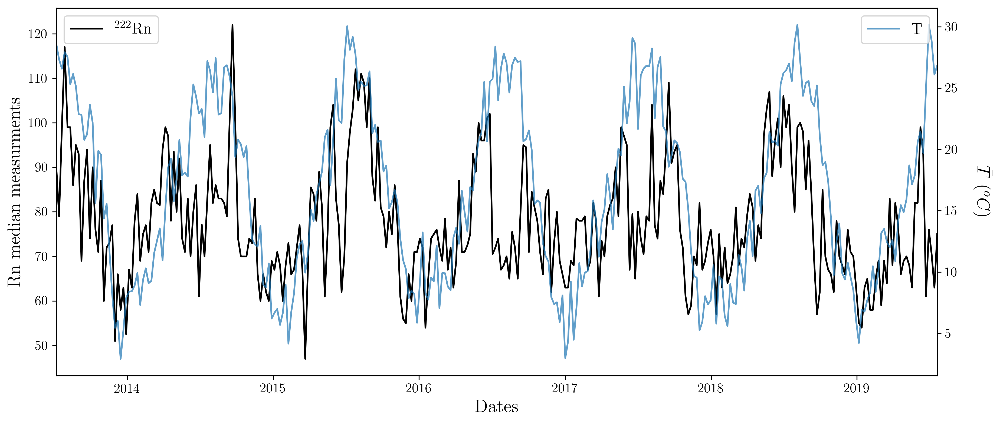

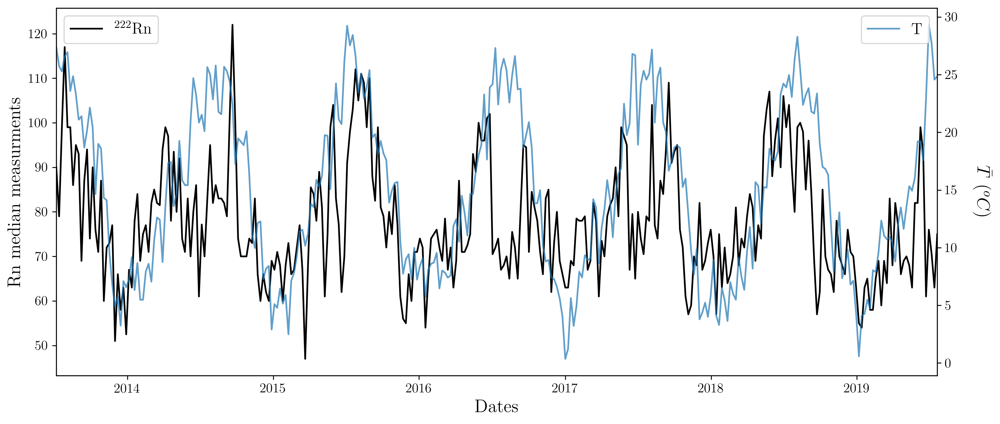

In [7]:
Rn_Clima_plot(DF_list, mdnRnA, dates, 'tmed', arr_str, ylabel=r'\bar{T}\ (^o C)', c='#1f77b4', v='T')

In [8]:
for i in range(len(DF_list)):
    try:
        print('The correlation with the avg temperature in {} is: '.format(arr_str[i]),
              pearsonr(DF_list[i]['tmed'].values, mdnRnA)[0])
        print('The correlation with the avg wind velocity in {} is: '.format(arr_str[i]),
              pearsonr(DF_list[i]['velmedia'].values, mdnRnA)[0])
    except:
        continue

The correlation with the avg temperature in BCN is:  0.5262143364640888
The correlation with the avg wind velocity in BCN is:  0.053870777879961015
The correlation with the avg temperature in ZGZ is:  0.5342311364113062
The correlation with the avg wind velocity in ZGZ is:  -0.00529465334718264
The correlation with the avg temperature in HSC is:  0.5222280179913197
The correlation with the avg wind velocity in HSC is:  0.11646140639357289


## Averaged

In [8]:
BCN_avg = weekly['BCN_avg']
BCN_avg['fecha'] = pd.to_datetime(BCN_avg['fecha'])
NVR_avg = weekly['NVR_avg']
NVR_avg['fecha'] = pd.to_datetime(NVR_avg['fecha'])
HSC_avg = weekly['HSC_avg']
HSC_avg['fecha'] = pd.to_datetime(HSC_avg['fecha'])
ZGZ_avg = weekly['ZGZ_avg']
ZGZ_avg['fecha'] = pd.to_datetime(ZGZ_avg['fecha'])
DFavg_list = [BCN_avg, NVR_avg, ZGZ_avg, HSC_avg]
arravg_str = ['BCN_avg', 'NVR_avg', 'ZGZ_avg', 'HSC_avg']

/usr/local/lib64/python3.6/site-packages/pandas/plotting/_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)


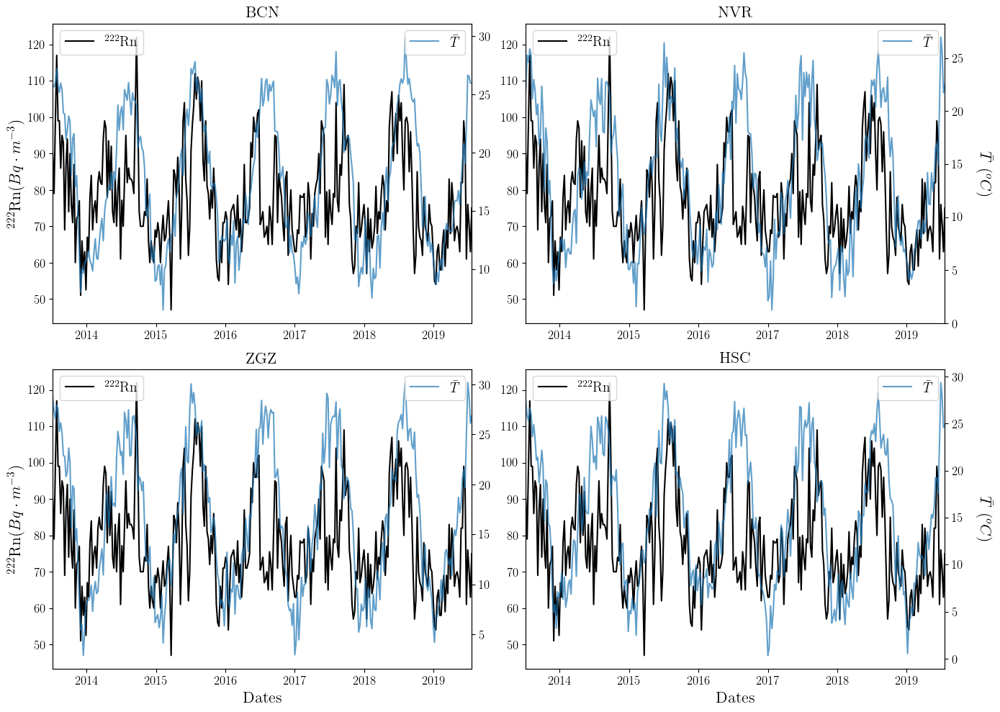

In [9]:
fig = plt.figure(3, figsize=(14, 10), dpi=100)
Rn_Clima_subplots(DFavg_list, mdnRnA, dates, 'tmed', arr_str, ylabel=r'\bar{T}\ (^o C)', legend=r'\bar{T}', 
                  c='#1f77b4', v='T')

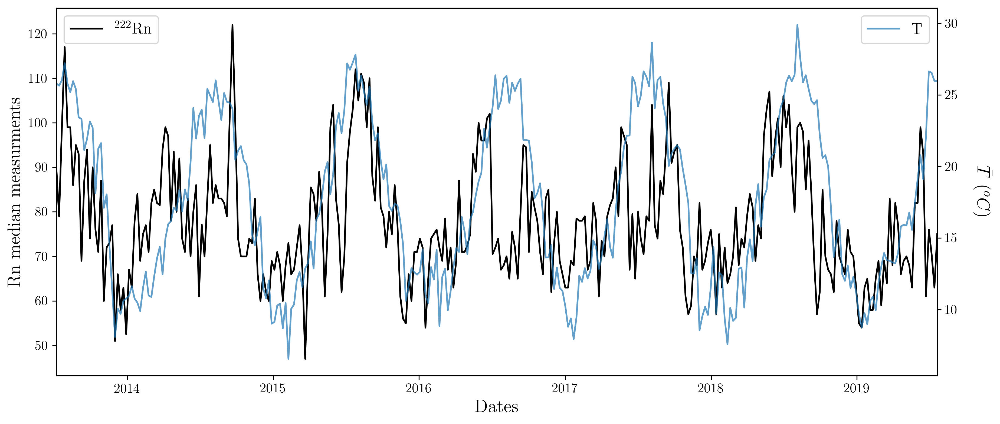

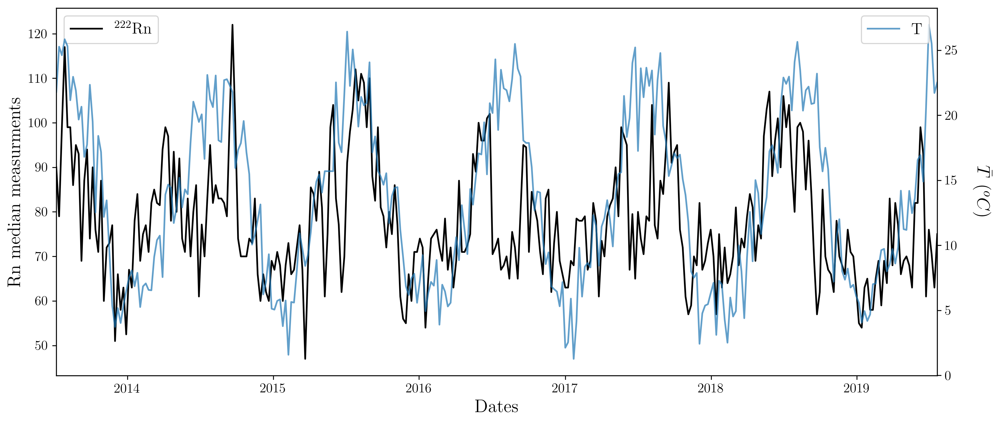

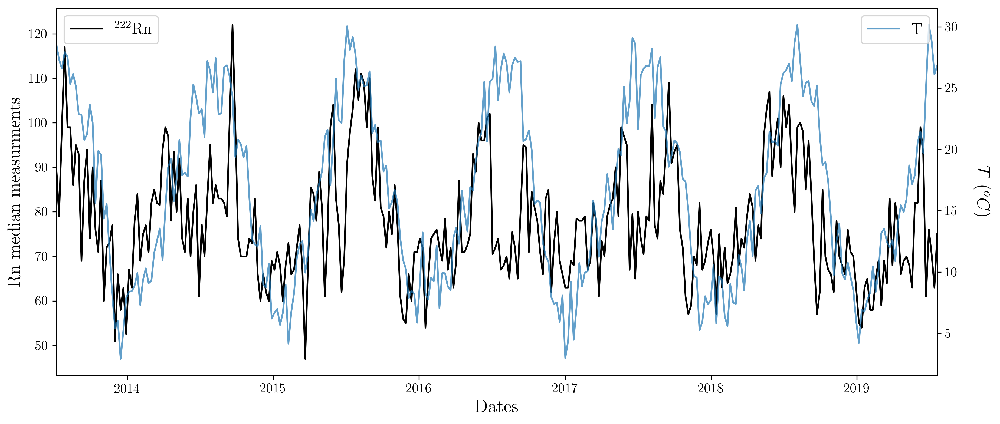

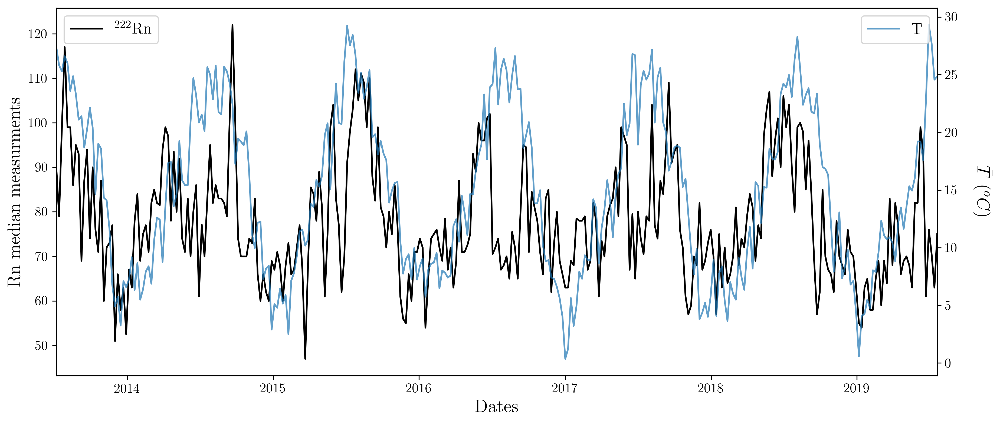

In [11]:
Rn_Clima_plot(DFavg_list, mdnRnA, dates, 'tmed', arr_str, ylabel=r'\bar{T}\ (^o C)', c='#1f77b4', v='T')

In [12]:
for i in range(len(DF_list)):
    try:
        print('The correlation with the avg temperature in {} is: '.format(arravg_str[i]),
              pearsonr(DFavg_list[i]['tmed'].values, mdnRnA)[0])
    except:
        continue

The correlation with the avg temperature in BCN_avg is:  0.5261748878387967
The correlation with the avg temperature in NVR_avg is:  0.5155144212888039
The correlation with the avg temperature in ZGZ_avg is:  0.5346255175384618
The correlation with the avg temperature in HSC_avg is:  0.5224156042992765


# Plots with Preassure

## Not nulls

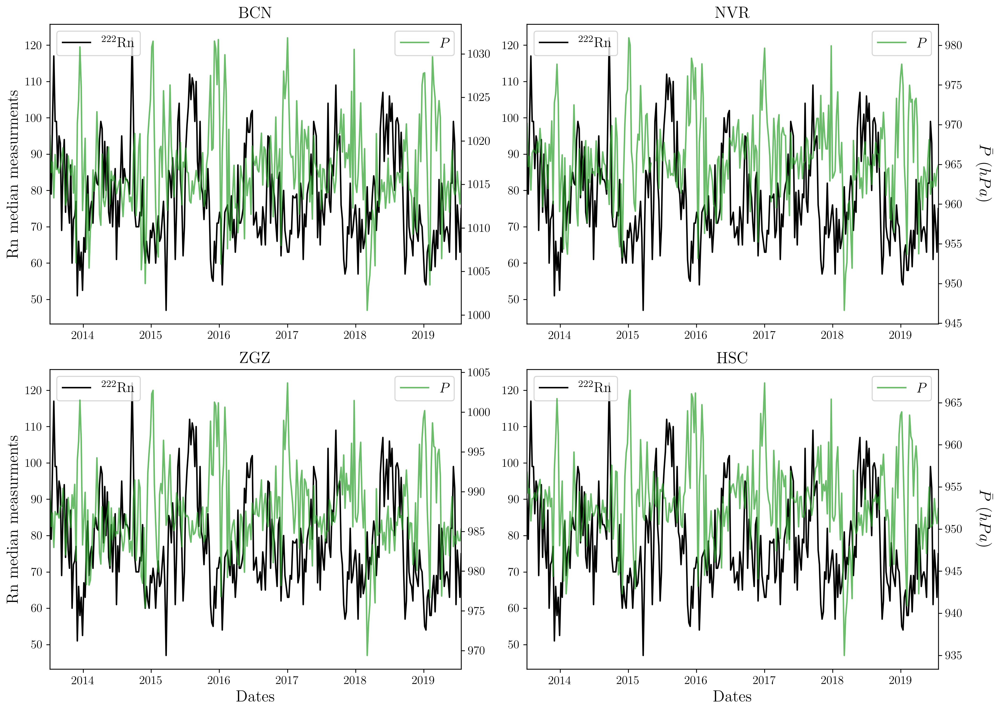

In [13]:
fig = plt.figure(3, figsize=(14, 10), dpi=300)
Rn_Clima_subplots(DF_list, mdnRnA, dates, 'presmed', arr_str, ylabel=r'\bar{P}\ (hPa)', c='#2ca02c', v='P')

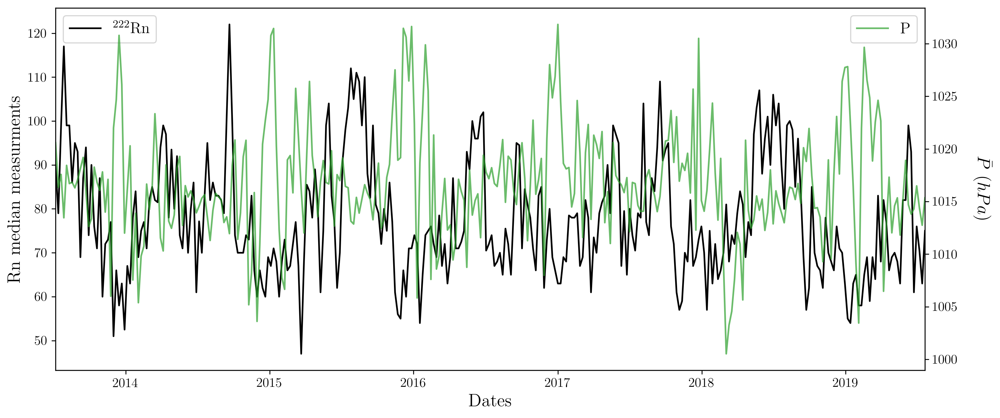

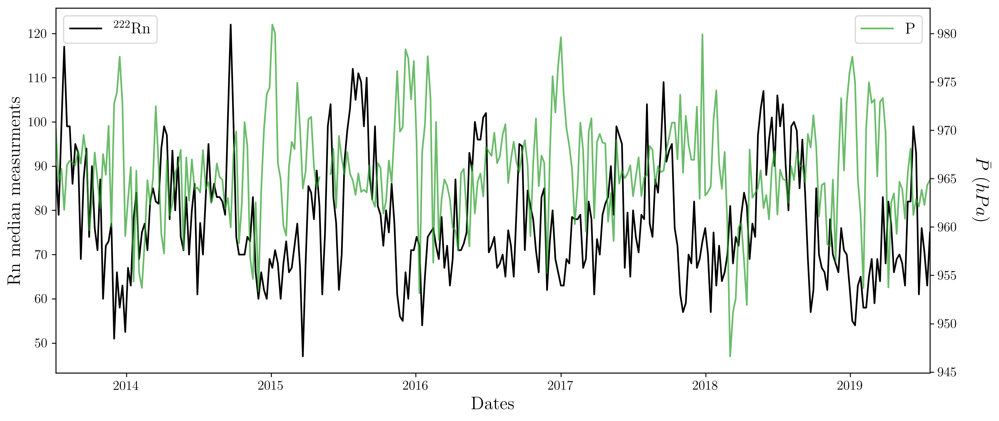

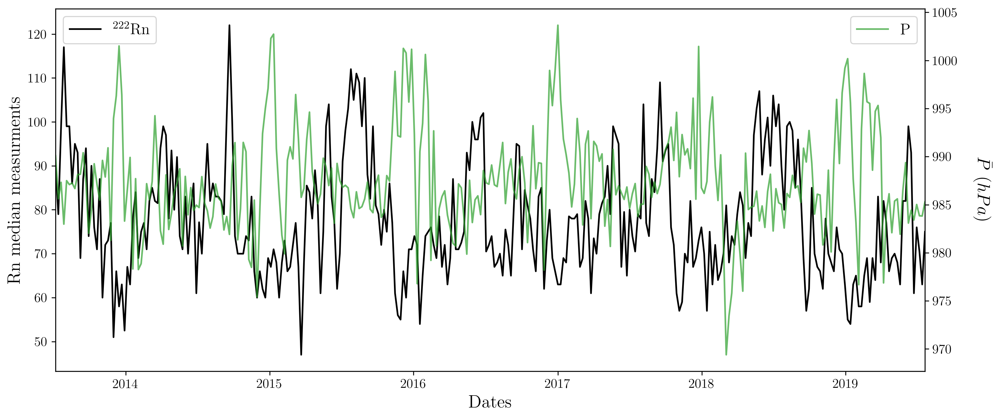

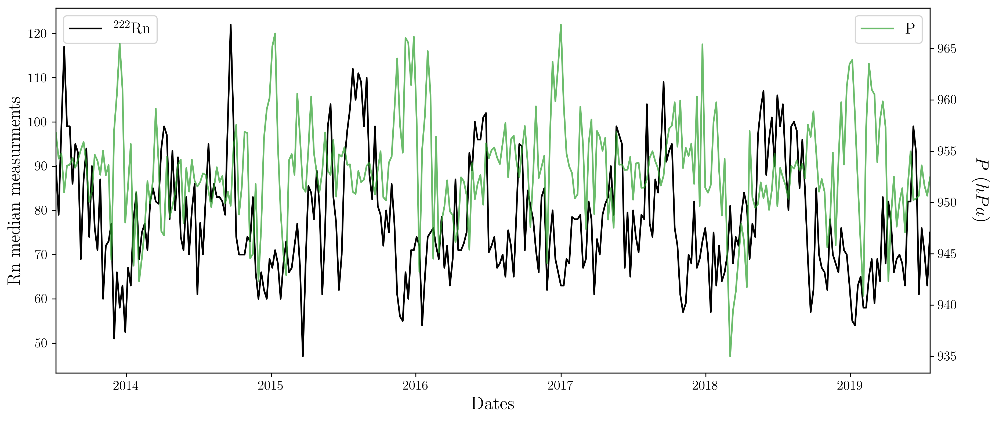

In [14]:
Rn_Clima_plot(DF_list, mdnRnA, dates, 'presmed', arr_str, ylabel=r'\bar{P}\ (hPa)', c='#2ca02c', v='P')

In [15]:
for i in range(len(DF_list)):
    try:
        print('The correlation with the avg preassure in {} is: '.format(arr_str[i]),
              pearsonr(DF_list[i]['presmed'].values, mdnRnA)[0])
    except:
        continue

The correlation with the avg preassure in BCN is:  -0.20553731221222
The correlation with the avg preassure in ZGZ is:  -0.26505407100613787
The correlation with the avg preassure in HSC is:  -0.16403891724731468


## Averaged

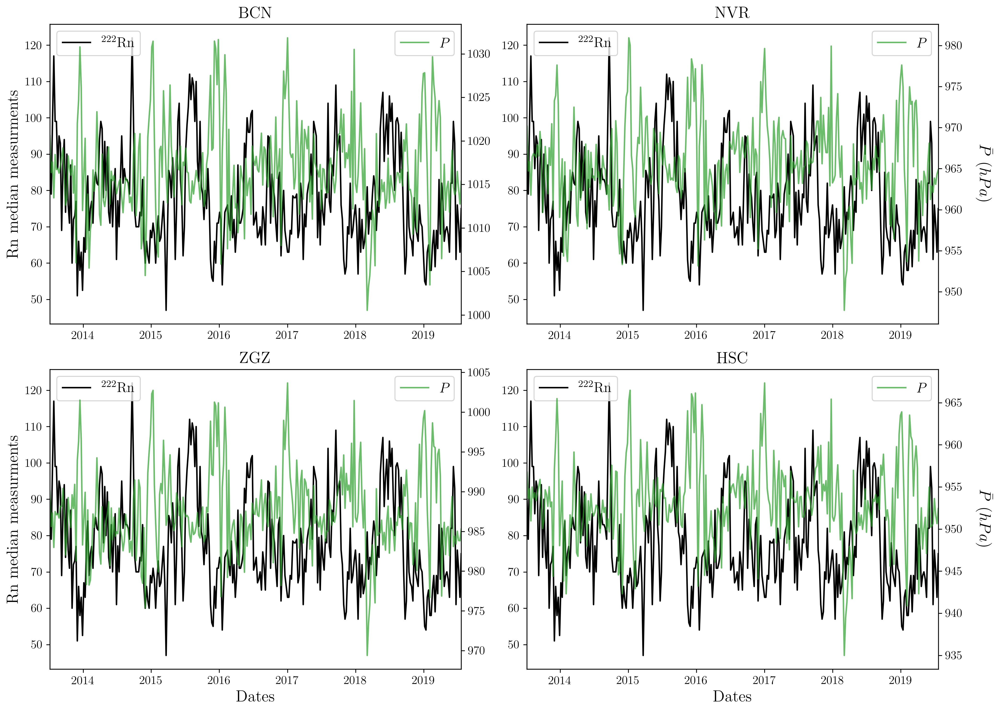

In [16]:
fig = plt.figure(4, figsize=(14, 10), dpi=300)
Rn_Clima_subplots(DFavg_list, mdnRnA, dates, 'presmed', arr_str, ylabel=r'\bar{P}\ (hPa)', c='#2ca02c', v='P')

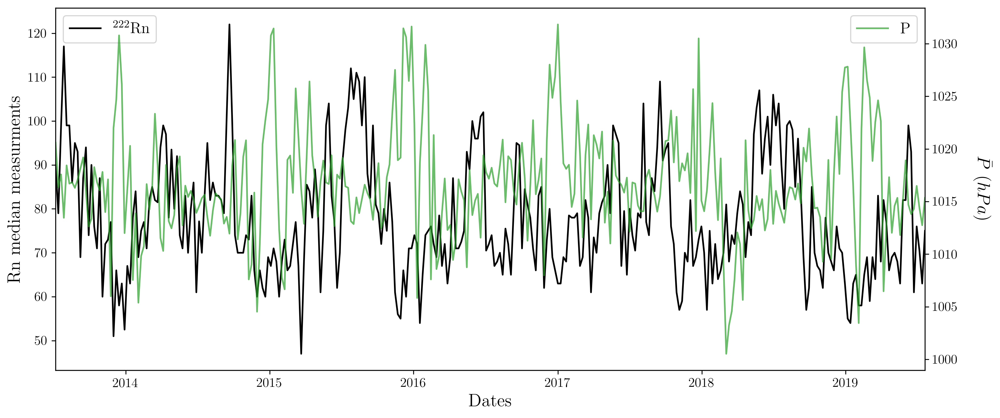

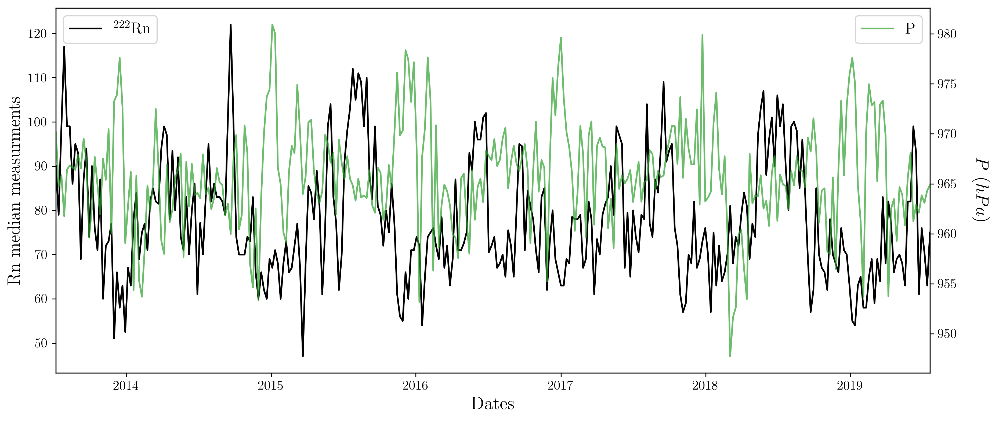

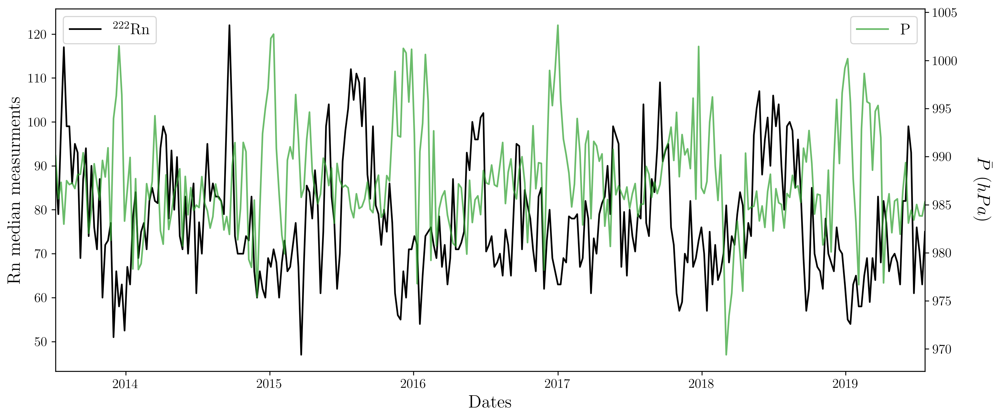

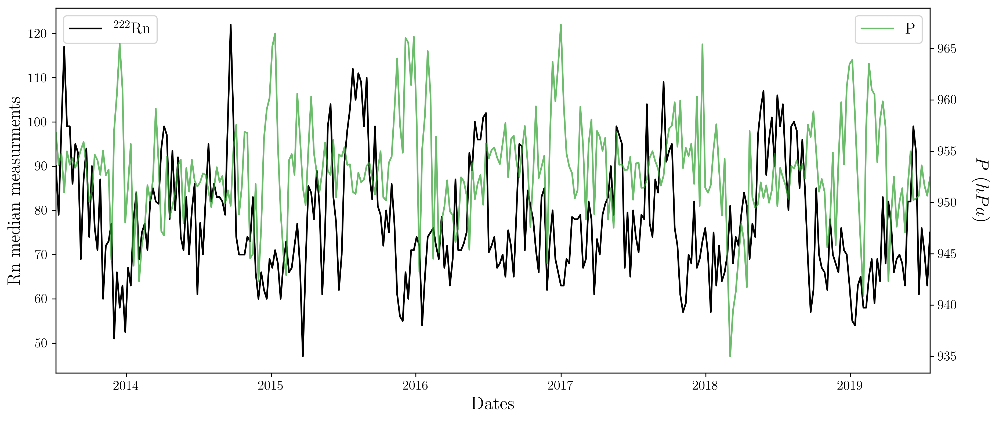

In [17]:
Rn_Clima_plot(DFavg_list, mdnRnA, dates, 'presmed', arr_str, ylabel=r'\bar{P}\ (hPa)', c='#2ca02c', v='P')

In [18]:
for i in range(len(DF_list)):
    try:
        print('The correlation with the avg preassure in {} is: '.format(arr_str[i]),
              pearsonr(DFavg_list[i]['presmed'].values, mdnRnA)[0])
    except:
        continue

The correlation with the avg preassure in BCN is:  -0.20845729390189938
The correlation with the avg preassure in NVR is:  -0.188215311885965
The correlation with the avg preassure in ZGZ is:  -0.2653543603660926
The correlation with the avg preassure in HSC is:  -0.16095891912021665


# Plots with Wind velocity

## Not nulls

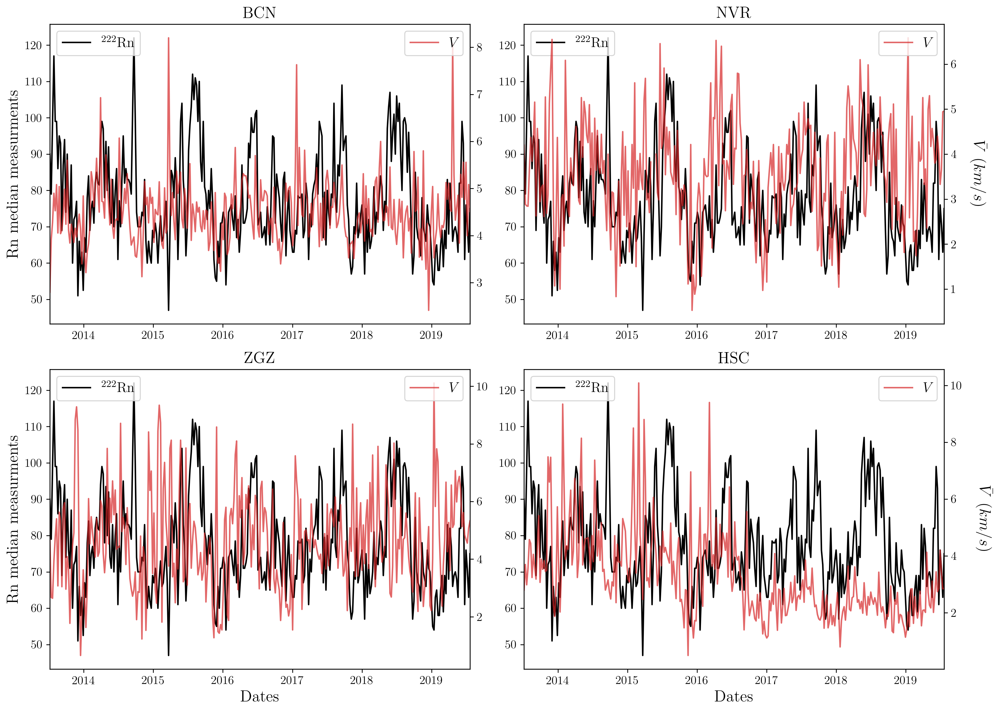

In [19]:
fig = plt.figure(5, figsize=(14, 10), dpi=300)
Rn_Clima_subplots(DF_list, mdnRnA, dates, 'velmedia', arr_str, ylabel=r'\bar{V}\ (km/s)', c='#d62728', v='V')

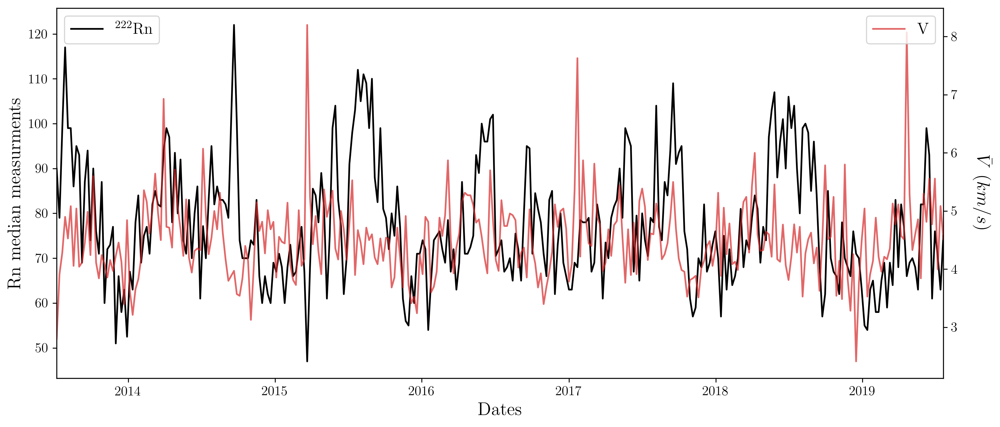

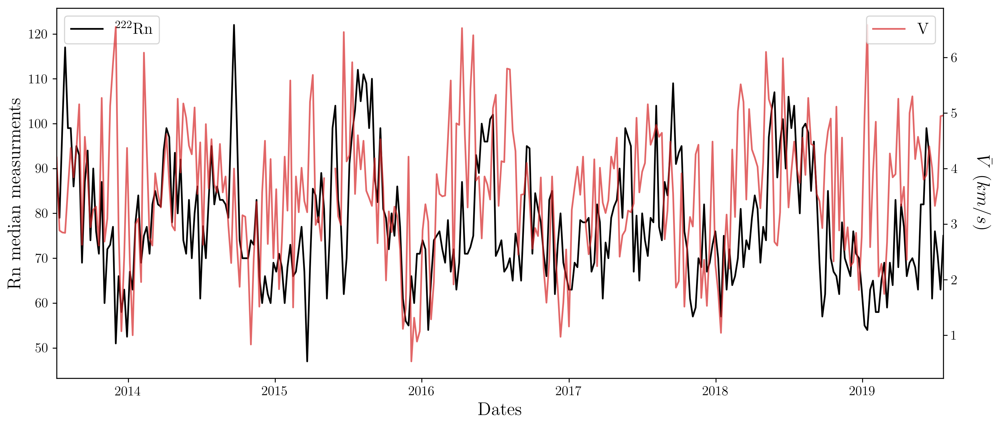

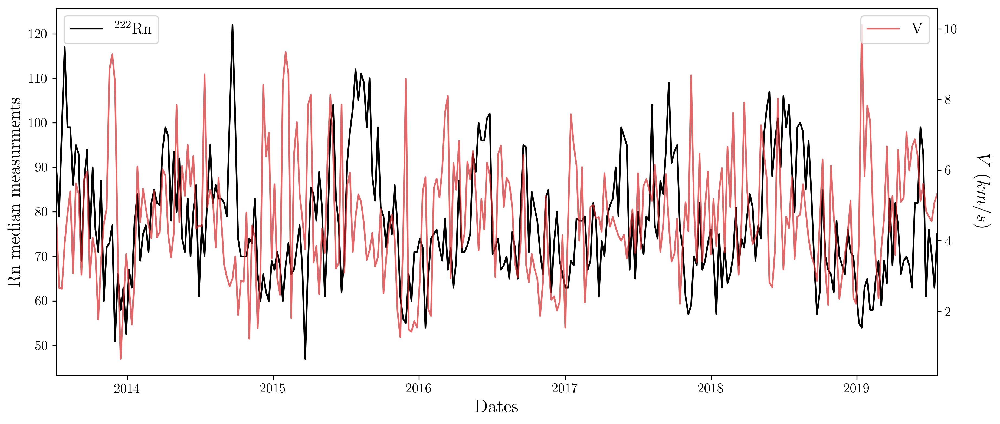

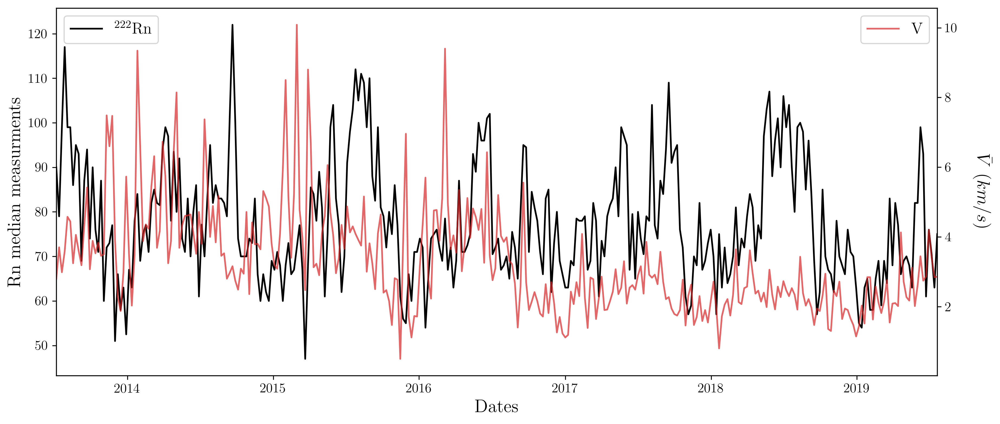

In [21]:
Rn_Clima_plot(DF_list, mdnRnA, dates, 'velmedia', arr_str, ylabel=r'\bar{V}\ (km/s)', c='#d62728', v='V')

In [22]:
for i in range(len(DF_list)):
    try:
        print('The correlation with the avg preassure in {} is: '.format(arr_str[i]),
              pearsonr(DF_list[i]['velmedia'].values, mdnRnA)[0])
    except:
        continue

The correlation with the avg preassure in BCN is:  0.053870777879961015
The correlation with the avg preassure in ZGZ is:  -0.00529465334718264
The correlation with the avg preassure in HSC is:  0.11646140639357289


## Averaged

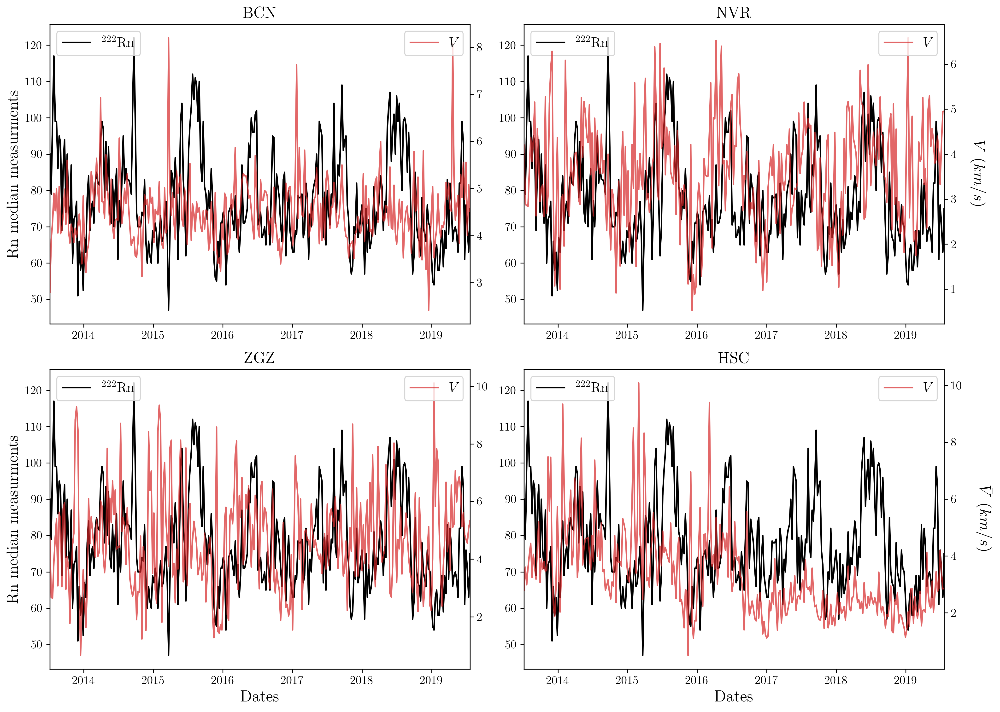

In [23]:
fig = plt.figure(5, figsize=(14, 10), dpi=300)
Rn_Clima_subplots(DFavg_list, mdnRnA, dates, 'velmedia', arr_str, ylabel=r'\bar{V}\ (km/s)', c='#d62728', v='V')

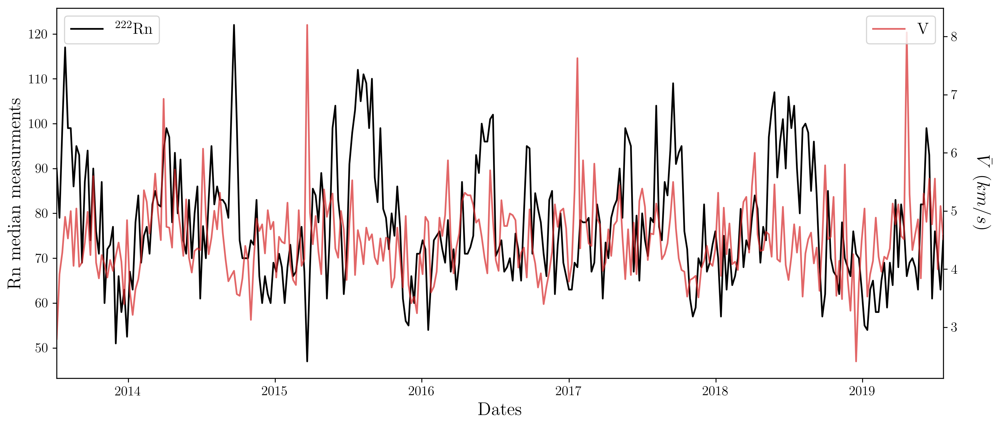

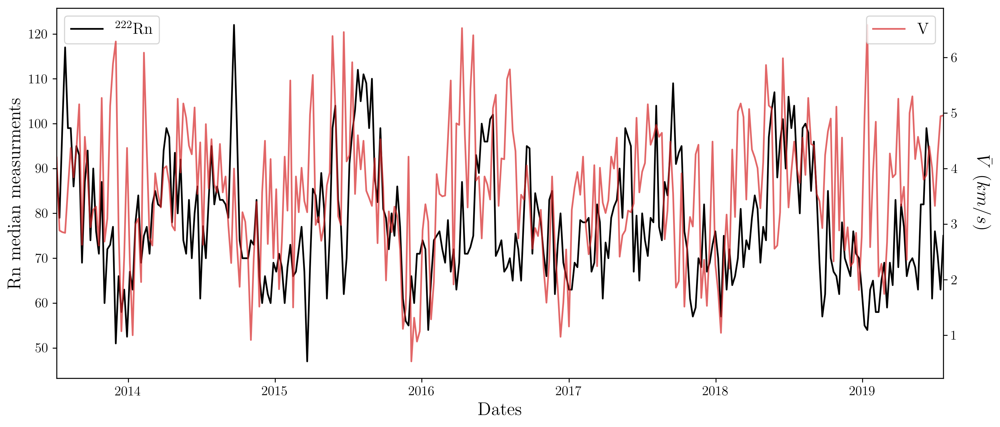

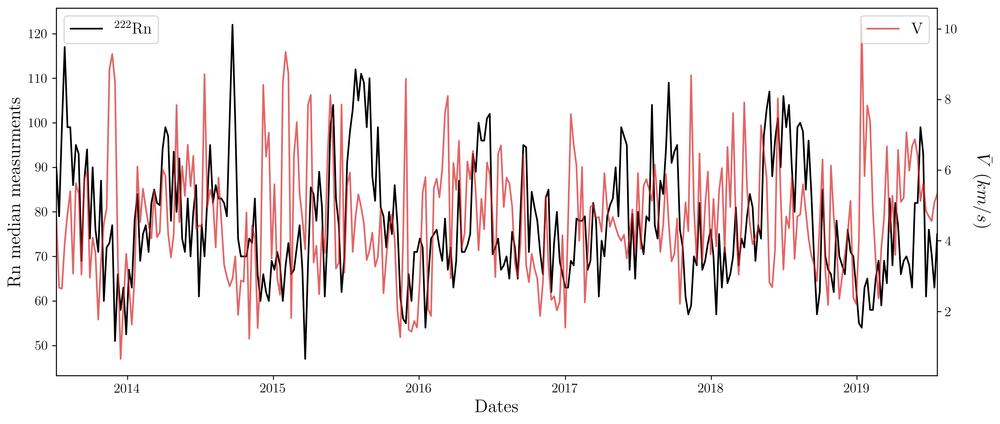

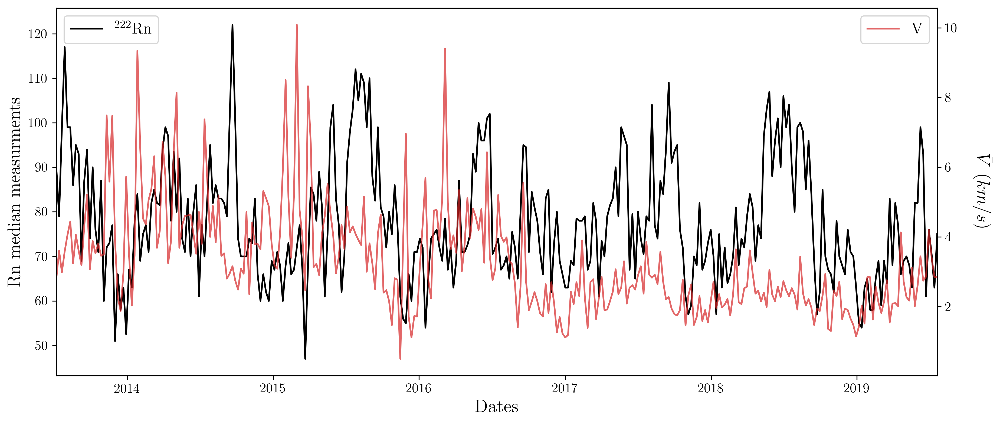

In [24]:
Rn_Clima_plot(DFavg_list, mdnRnA, dates, 'velmedia', arr_str, ylabel=r'\bar{V}\ (km/s)', c='#d62728', v='V')

In [25]:
for i in range(len(DF_list)):
    try:
        print('The correlation with the avg preassure in {} is: '.format(arr_str[i]),
              pearsonr(DFavg_list[i]['velmedia'].values, mdnRnA)[0])
    except:
        continue

The correlation with the avg preassure in BCN is:  0.05840364971942606
The correlation with the avg preassure in NVR is:  0.172787095577137
The correlation with the avg preassure in ZGZ is:  -0.005949726459692148
The correlation with the avg preassure in HSC is:  0.1159108135263962
